# Airbnb project - Final project in the course "Data Science for Mobility"

- Katrine Bay s183910
- Gustav Larsen s180820
- Rasmus Aagaard s164419
- Mathilde Block s204201

## Introduction
Airbnb listings are a great way to find a place to stay when traveling. However, there is a great deal variability across listings and finding what matches your needs might not exactly be easy. For example, there are many factors that influence the price of a listing, and it is not always easy to find the right one. As a host for a listing, there might also be great insights hidden in the data as to how you make your listing more attractive to potential guests. This project aims to explore a dataset of Airbnb listings in Copenhagen, Denmark while using methods learned in the course. The dataset provided by the class consists of 13815 listings with 18 features.  Additional CSV files are from [InsideAirbnb](http://insideairbnb.com/get-the-data/) and contain quarterly data for the last 12 months. 



## Data analysis and visualization

In [1]:
# loading packages etc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
pd.set_option('display.max_rows', 500)


In [2]:
# read in the data
listings = pd.read_csv('data/listings_CPH.csv') # the provided project data
listings_ = pd.read_csv('data/listings.csv') 
reviews = pd.read_csv('data/reviews.csv')
neighbourhoods = pd.read_csv('data/neighbourhoods.csv')

# gz zipped files
calendar_gz = pd.read_csv('data/calendar.csv.gz', compression='gzip',
                   error_bad_lines=False)
listings_gz = pd.read_csv('data/listings.csv.gz',compression='gzip',
                   error_bad_lines=False)                   
reviews_gz = pd.read_csv('data/reviews.csv.gz',compression='gzip',
                   error_bad_lines=False)  

In [3]:
listings.shape

(13815, 18)

In [4]:
# joining dataframes 
df_reviews = pd.merge(reviews, reviews_gz, on = ['listing_id','date'])

cols_to_use = listings_.columns.difference(listings_gz.columns)
df_listings = pd.merge(listings_gz, listings_[cols_to_use], left_index=True, right_index=True, how='outer')
df_listings.price = df_listings.price.str.replace('$', '')
df_listings.price = df_listings.price.str.replace(',', '')
df_listings.price = pd.to_numeric(df_listings['price'])


## Map of Copenhagen with Airbnb listings

To get an overview of the data, we will start by plotting the Airbnb listings on a map of Copenhagen. The map is created using the [Folium](https://python-visualization.github.io/folium/) library. The map is interactive, and the listings can be clicked on to show the neighborhood of the listing together with the price of the listing. To investigate how the pricing differs based on location in copehagen, the listings have been colored acording to 5 price quantiles rangein from <span style="color:blue">blue</span> (the cheapest and 0-20% of the price range), <span style="color:green">green</span> (20-40%), <span style="color:yellow">yellow</span> (40-60%), <span style="color:orange">orange</span> (60-80%), and <span style="color:red">red</span> (the top 20% of the price range). 

The map is created by using the function 'plot_map' which takes the dataframe as input. The function uses the latitude and longitude of the listings to plot the listings on the map. The function also takes the column name of the price as input, and uses this to color the listings. The function also takes the name of the column containing the neighborhood as input, and uses this to show the neighborhood when the listing is clicked on.

In [5]:
import folium
traffic_map = folium.Map(location=[55.687654, 12.544755], zoom_start=13)
df_listings['price_index_quartile'] = pd.qcut(df_listings['price'], 5, labels=False)
colordict = {0: 'blue', 1: 'green', 2: 'yellow', 3: 'orange', 4: 'red'} 


for lat, lon, price_q, neighbourhood_cleansed, price in zip(df_listings['latitude'], df_listings['longitude'],df_listings['price_index_quartile'], df_listings['neighbourhood_cleansed'], df_listings['price']):
    folium.CircleMarker(
        [lat, lon],
         popup = ('Neighbourhood: ' + str(neighbourhood_cleansed).capitalize() + '<br>'
                  'Price: ' + str(price)
                 ),
        color='b',
        radius=5,
        key_on = price_q,
        fill_color=colordict[price_q],
        fill=True,
        fill_opacity=0.4
        ).add_to(traffic_map)
traffic_map

## Interpretation of map

The map shows that the listings are spread out all over Copenhagen. Generally, the listings are more concentrated in the center of Copenhagen, and the price of the listings increases the closer to the center of Copenhagen the listing is. The map also shows that there are some areas in Copenhagen where there are no listings. This could be due to the fact that some areas of Copenhagen are under construction, or that there simply are no Airbnb hosts in these areas.

The trend of pricing is also visible in the map. The listings in the center of Copenhagen are more expensive than the listings in the outskirts of Copenhagen. 

To Investigate this further, a boxplot of the pricing in each neighbordhood is presented below. 

<!-- This is also visible in the histogram of the prices, which shows that the prices are more concentrated in the lower price range in the outskirts of Copenhagen, while the prices are more concentrated in the higher price range in the center of Copenhagen. -->


<!-- The most listings are in the center of Copenhagen, and the fewest listings on the outer rim of Copenhagen city.  -->



In [6]:
# investigate which neighbordhood has the larges density of listings

# create a new dataframe with the number of listings per neighbourhood
df_neighbourhoods = pd.DataFrame(df_listings['neighbourhood_cleansed'].value_counts())
df_neighbourhoods.reset_index(inplace=True)
df_neighbourhoods.columns = ['neighbourhood_cleansed', 'listings_count']

# add mean price for each neighbourhood
df_neighbourhoods = pd.merge(df_neighbourhoods, df_listings.groupby('neighbourhood_cleansed')['price'].mean(), on='neighbourhood_cleansed')

Text(0.5, 0, 'Neighbourhood')

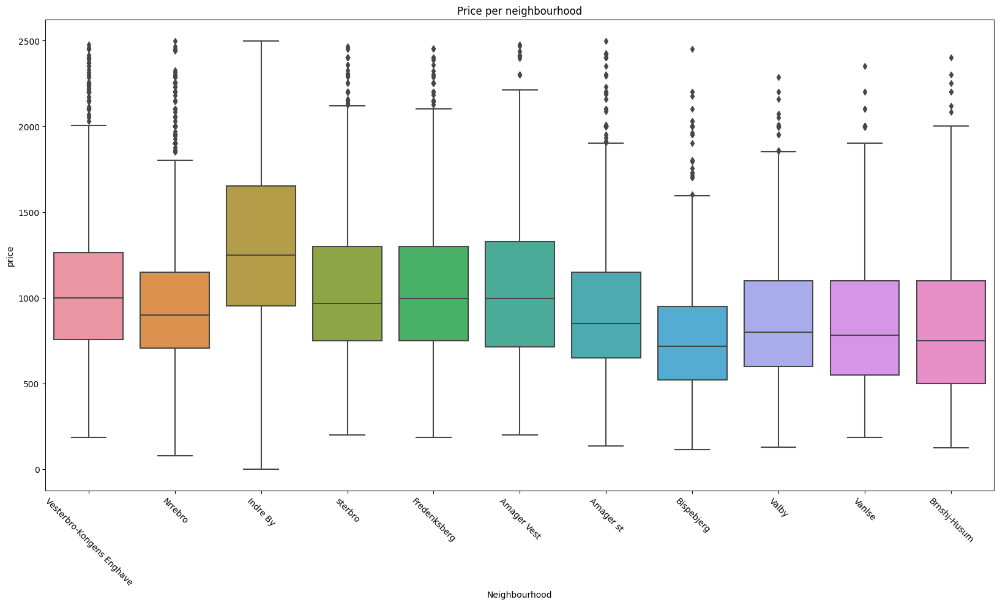

In [7]:
# boxplot of price per neighbourhood and number of listings per neighbourhood

# define the order of the distributions in the boxplot
frequency_order = df_neighbourhoods.sort_values('listings_count', ascending=False)['neighbourhood_cleansed'].values
 
fig, ax = plt.subplots(figsize=(20,10))
sns.boxplot(x='neighbourhood_cleansed', y='price', data=df_listings[df_listings.price < 2500], ax=ax,order = frequency_order)
ax.set_xticklabels(ax.get_xticklabels(), rotation=-45)
ax.set_title('Price per neighbourhood')
ax.set_xlabel('Neighbourhood')

## Interpretation of boxplot

The boxplot supports the claim that the price of the listings in the center of Copenhagen is higher than the price of the listings in the outskirts of Copenhagen. The boxplot also shows that the price of the listings in the center of Copenhagen is more spread out and have higher dispersion than the price of the listings in the outskirts of Copenhagen. 

The distributions of the box plot is ordered to present the neighborhood with the most listings (Vesterbro-Kongens Enghave) to the neighborhood with the fewest listings (Brønshøj-Husum). This is done to make it easier to compare the neighborhoods.

# Room type paradox

We will now investigate whether the trend in pricing and neighborhood is caused by the fact, that some neighborhoods simply charge more for the rent than others, or if the trend is caused by the fact that the distributions of room types differ between the neighborhoods. It could be, that the expensive neighborhoods, towards the center of Copenhagen, host a larger amount of the more expensive room types than the neighborhoods towards the outskirts of Copenhagen. If this would be the case, a Simpsons' paradox would be found in the neighborhood pricing. 

To investiagte this, we create a barplot of the room types price in each neighborhood, followed by looking into the frequency of the room types in each neighborhood.

<!-- We will call this the room type paradox. The room type paradox is the claim that the room type of the listing is the main factor in determining the price of the listing, and not the neighborhood of the listing. -->


<!-- the room type paradox. The room type paradox is the claim that the price of a listing is higher if the listing is a private room than if the listing is a shared room. This is counterintuitive, as a shared room is cheaper than a private room. -->

<!-- Idea: is this just a product of the fact that there are a higher concentrarion of the expensive room types in the center of copenhagen? Is this a simpsons paradox?  -->



Text(0.5, 0, 'Neighbourhood')

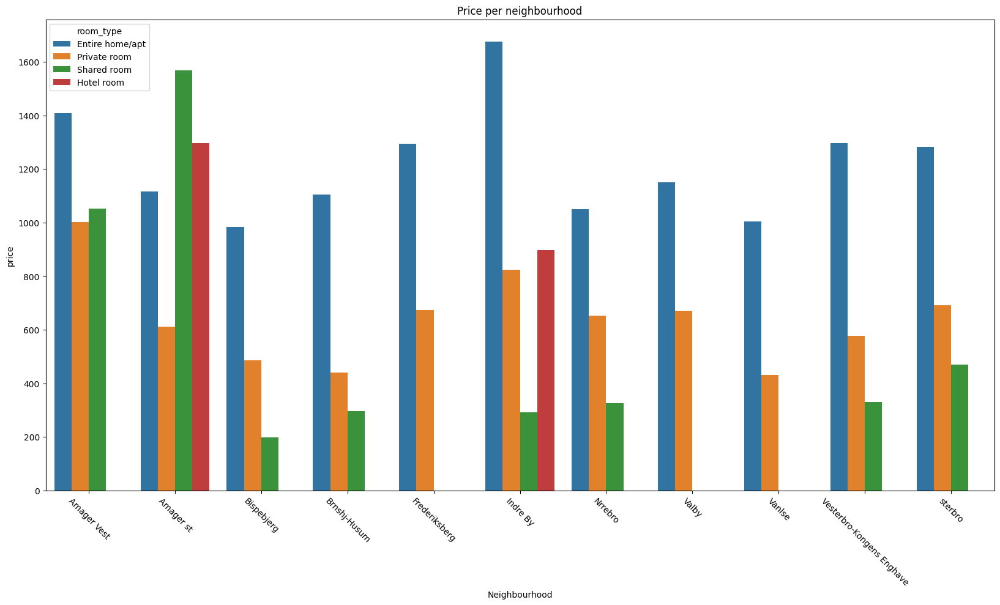

In [8]:
# what room_type has the neighborhoods the most of?
df_listings.groupby(['neighbourhood_cleansed','room_type'])['room_type'].count()

# add mean price of each room type to the dataframe
df_room_type = pd.DataFrame(df_listings.groupby(['neighbourhood_cleansed','room_type'])['price'].mean())
df_room_type.reset_index(inplace=True)
df_room_type.columns = ['neighbourhood_cleansed', 'room_type', 'price']

# bar plot of room_types in each neighborhood
fig, ax = plt.subplots(figsize=(20,10))
sns.barplot(x='neighbourhood_cleansed', y='price', hue='room_type', data=df_room_type, ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=-45)
ax.set_title('Price per neighbourhood')
ax.set_xlabel('Neighbourhood')


We quickly observe, the pricing for an entire home is the most expensive in Indre by. Generally, the pricing of the room type 'Entire home/apt' is the most expensive one, followed by the pricing of the room type 'Private room', and the pricing of the room type 'Shared room' is the cheapest. 

One neighborhood sticks out, as the pricing of a shared room in 'Amager st' is significantly higher than the pricing of a shared room in the other neighborhoods. We will investigate tese two neighborhoods further by looking into the frequency of the room types in each neighborhood.  

<!-- Whether this could be due to the fact, that there is a very small amount of shared rooms in 'Amager st', and the other neighborhoods have more shared rooms, we will now investigate. -->

In [9]:
df_room_type[df_room_type.neighbourhood_cleansed.isin(['Indre By', 'Amager st'])]

,neighbourhood_cleansed,room_type,price
3,Amager st,Entire home/apt,1115.591116
4,Amager st,Hotel room,1296.000000
5,Amager st,Private room,612.090909
6,Amager st,Shared room,1567.500000
15,Indre By,Entire home/apt,1674.605152
16,Indre By,Hotel room,897.666667
17,Indre By,Private room,823.680000
18,Indre By,Shared room,292.000000


In [10]:
df_room_type_count = pd.DataFrame(df_listings.groupby(['room_type','neighbourhood_cleansed'])['room_type'].count())
df_room_type_count[df_room_type_count.index.get_level_values(1).isin(['Indre By', 'Amager st'])]

room_type
room_type       neighbourhood_cleansed           
Entire home/apt Amager st                     878
                Indre By                     1902
Hotel room      Amager st                       3
                Indre By                       12
Private room    Amager st                     143
                Indre By                      150
Shared room     Amager st                       2
                Indre By                        4

# Interpretation of the room type paradox

<!-- The hypothesis, that Indre by might be a more expensive neighborhood than Amager st due to the fact that Indre by host more Entire home/apt -->

For the shared room type, the pricing in Amager st is significantly higher - five times the price in Indre by. The pricing of the hotel room type in Amager st is likewise higher than the pricing of the hotel room type in Indre by. The pricing on private rooms doesn't differ disnificantly, and the pricing of the entire home/apt is higher in Indre by.

The small amount of the significantly more expensive room types in Amager st results in the entire neighbordhood being less expensive, as the amount of these doesn't impact the overall pricing of Amager st as a neighborhood.

Hence, when looking for an AirBnb in Copenhagen, one would benefit from looking into the pricing of room types in each neighborhood, rather than just looking into the pricing of the neighborhood.




<!-- The pricing of shared rooms in Amager st is significantly higher than the pricing of shared rooms in Indre by, but the small amount of shared rooms in Amager st does not impact the overall pricing of Amager st as a neighborhood.

There is only 2 shared rooms in Amager st, so eventhough this room type is approximately four times the price at Amager st than Indre by, it does not provide a significant 

We see, that the pricing of Shared rooms and Private rooms is hgiher in Amager st than in Indre by, but in combination with the fact, that the amount of Entire home/apt is higher in Indre by, we can conclude that the pricing of Entire home/apt is the main factor in determining the price of the listing, and not the neighborhood of the listing. -->